# CNN Visualizations with Dogs and Cats

Taking a peek inside CNNs with fastai 1.0

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from fastai import *
from fastai.vision import *

In [3]:
from sklearn.manifold import TSNE
import seaborn as sns
from sklearn import manifold, datasets
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.metrics import confusion_matrix
from scipy.spatial.distance import squareform
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.ticker import NullFormatter
import PIL

In [4]:
path = untar_data(URLs.PETS); path

PosixPath('/home/ubuntu/.fastai/data/oxford-iiit-pet')

In [5]:
path_anno = path/'annotations'
path_img = path/'images'

In [6]:
fnames = get_image_files(path_img)

In [7]:
np.random.seed(2)
pat = r'/([^/]+)_\d+.jpg$'

In [8]:
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(), size=224)
data.normalize(imagenet_stats)

The dataset we're using is the [Oxford-IIIT Pet Dataset](http://www.robots.ox.ac.uk/~vgg/data/pets/). We're going to build a model that classifies dog and cat breeds.

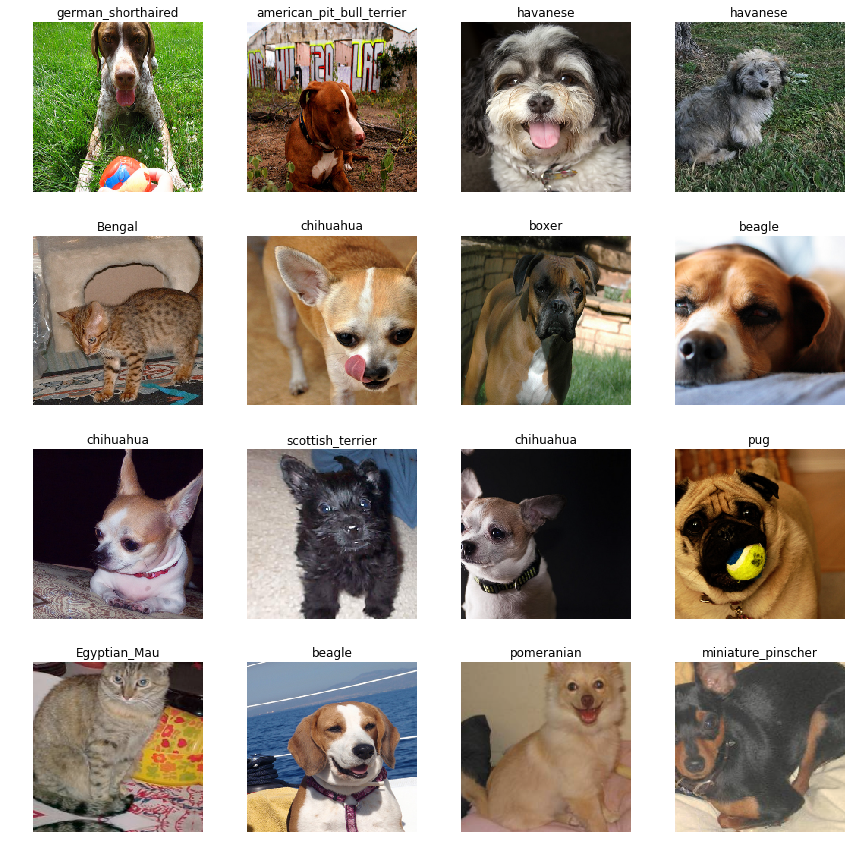

In [9]:
data.show_batch(rows=4, figsize=(12,12))

We will use a resnet34 based model

In [10]:
learn = ConvLearner(data, models.resnet34, metrics=error_rate)

In [22]:
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (rel

Train the linear layers of the model

In [14]:
learn.fit_one_cycle(4)

Total time: 03:55
epoch  train loss  valid loss  error_rate
1      1.163667    0.326334    0.101131    (01:22)
2      0.509859    0.271407    0.089820    (00:51)
3      0.308209    0.227998    0.078510    (00:51)
4      0.231096    0.216773    0.068530    (00:50)



`fit_one_cycle` trains using a single ramp up/ramp down cycle as shown

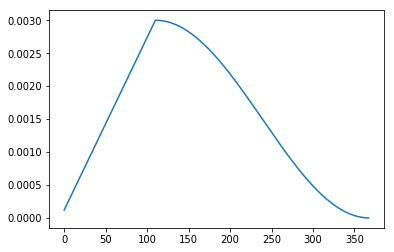

In [15]:
learn.recorder.plot_lr()

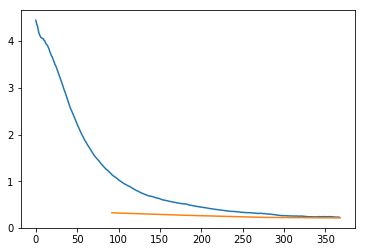

In [16]:
learn.recorder.plot_losses()

Train the entire model, including the resnet backbone

In [17]:
learn.unfreeze()
learn.fit_one_cycle(2, max_lr=slice(1e-6,1e-4))

Total time: 02:10
epoch  train loss  valid loss  error_rate
1      0.222477    0.208521    0.065203    (01:05)
2      0.186001    0.204716    0.064538    (01:04)



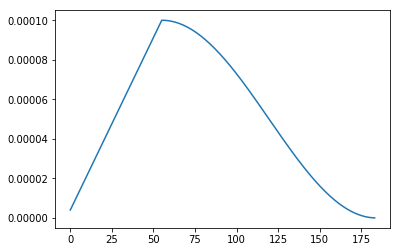

In [18]:
learn.recorder.plot_lr()

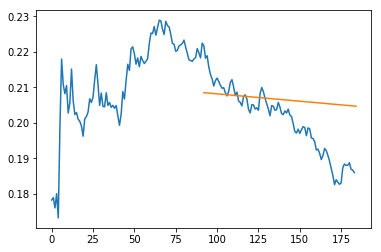

In [19]:
learn.recorder.plot_losses()

In [20]:
learn.save('pets_1')

In [12]:
learn.load('pets_1')

We can look at the examples where the model is failing

In [23]:
interp = ClassificationInterpretation.from_learner(learn)

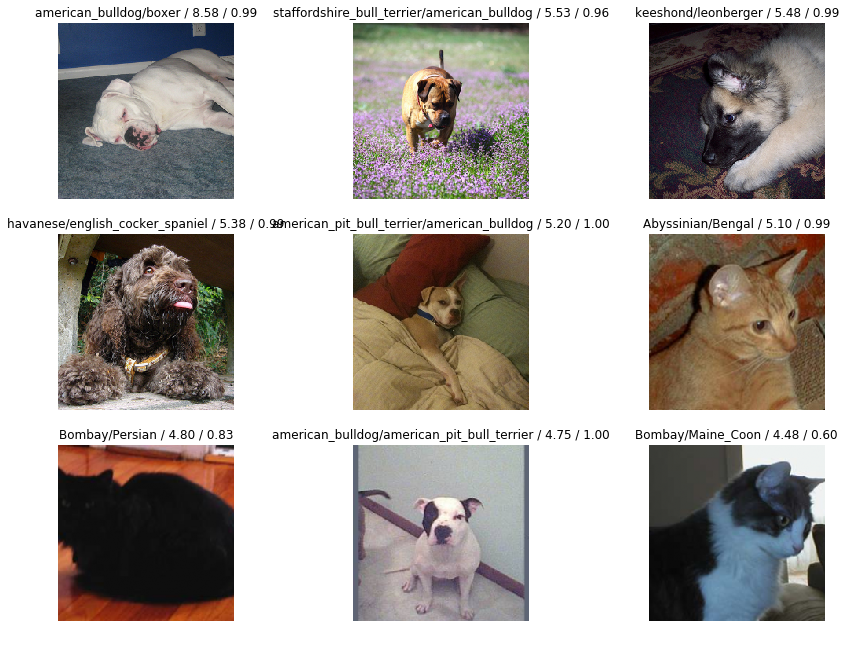

In [24]:
interp.plot_top_losses(9, figsize=(15,11))

The actual predictions output by the model are 1x37 vectors corresponding to predictions of what class the image belongs to

In [25]:
preds = interp.y_pred
y = interp.y_true

In [26]:
preds[500]

tensor([-3.3157, -1.7554,  1.3896,  0.9969, -1.3417,  3.6941, -1.8038, -2.2852,
        -0.8575,  1.9085, -0.5067, -1.8416, -0.7558, -3.2211, -3.3148, -2.7729,
        -0.6922, -1.9639, -0.0850, -0.4779, -1.5137, -0.1993, 15.2399, -0.1837,
         0.1327, -0.9628,  0.0745,  1.4494, -1.3126,  1.6405, -0.4389,  0.4277,
         0.3962,  5.1095,  0.6675, -0.2931, -1.6850])

We can use a softmax function to turn the output vector into a vector of probabilities for the image beloning to each class. Notice how one value is very close to 1, and the rest are very close to 0.

In [27]:
F.softmax(preds[500], dim=0)

tensor([8.7375e-09, 4.1593e-08, 9.6570e-07, 6.5210e-07, 6.2904e-08, 9.6763e-06,
        3.9625e-08, 2.4485e-08, 1.0209e-07, 1.6226e-06, 1.4498e-07, 3.8158e-08,
        1.1302e-07, 9.6043e-09, 8.7455e-09, 1.5035e-08, 1.2043e-07, 3.3765e-08,
        2.2104e-07, 1.4922e-07, 5.2962e-08, 1.9715e-07, 9.9994e-01, 2.0025e-07,
        2.7480e-07, 9.1879e-08, 2.5925e-07, 1.0253e-06, 6.4759e-08, 1.2411e-06,
        1.5515e-07, 3.6906e-07, 3.5763e-07, 3.9848e-05, 4.6909e-07, 1.7951e-07,
        4.4626e-08])

The index of the largest value in the vector corresponds to the class prediction

In [28]:
learn.data.valid_ds.ds.classes[np.argmax(to_np(F.softmax(preds[500], dim=0)))]

'wheaten_terrier'

Which we hope is the same as the ground truth value

In [31]:
learn.data.valid_ds.ds.classes[to_np(y[500])]

'wheaten_terrier'

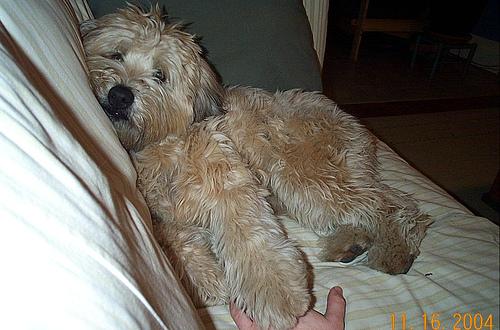

In [29]:
PIL.Image.open(learn.data.valid_ds.ds.x[500])

We can perform t-SNE on our model's output vectors. As these vectors are from the final classification, we would expect them to cluster well.

In [32]:
probs_trans = manifold.TSNE(n_components=2, perplexity=15).fit_transform(preds)

In [33]:
prob_df = pd.DataFrame(np.concatenate((probs_trans, y[:,None]), axis=1), columns=['x','y','labels'])

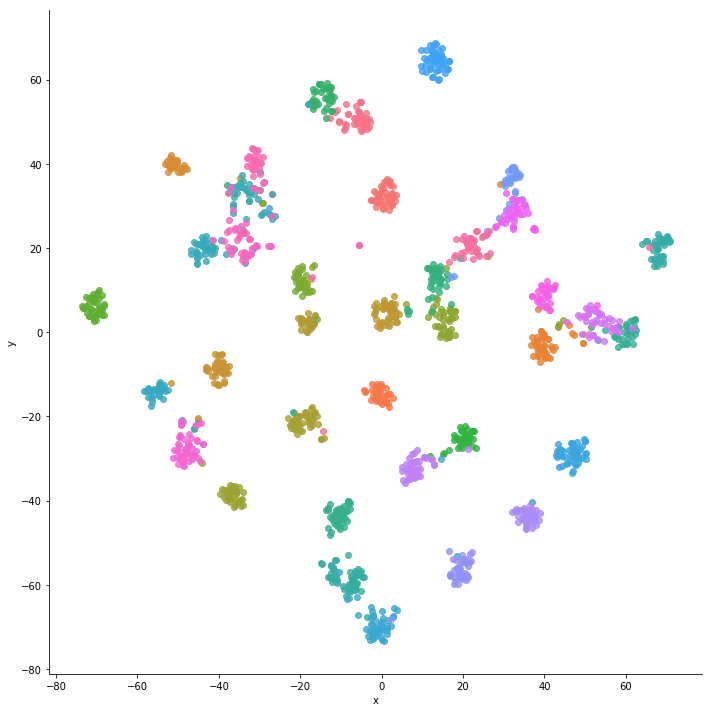

In [34]:
g = sns.lmplot('x', 'y', data=prob_df, hue='labels', fit_reg=False, legend=False, height=10)

In [35]:
prob_df['fname'] = learn.data.valid_ds.ds.x

And we can make an interesting image by mapping pictures in the validation set to their predicted values

In [13]:
def visualize_scatter_with_images(scaled_data, df, figsize=(64,64), image_zoom=1, suffix=1):
    fig, ax = plt.subplots(figsize=figsize)
    artists = []
    xx = scaled_data[:,0]
    yy = scaled_data[:,1]
    
    for i, (x,y) in enumerate(zip(xx,yy)):
        im = PIL.Image.open(df['fname'][i])
        im.thumbnail((64,64))
        img = OffsetImage(im, zoom=image_zoom, cmap='gray')
        ab = AnnotationBbox(img, (x, y), xycoords='data', frameon=False)
        artists.append(ax.add_artist(ab))
    ax.update_datalim(np.column_stack([xx,yy]))
    ax.autoscale()
    
    fig.savefig(f'TSNE_{suffix}.jpg', bbox_inches = 'tight')
    return fig, ax

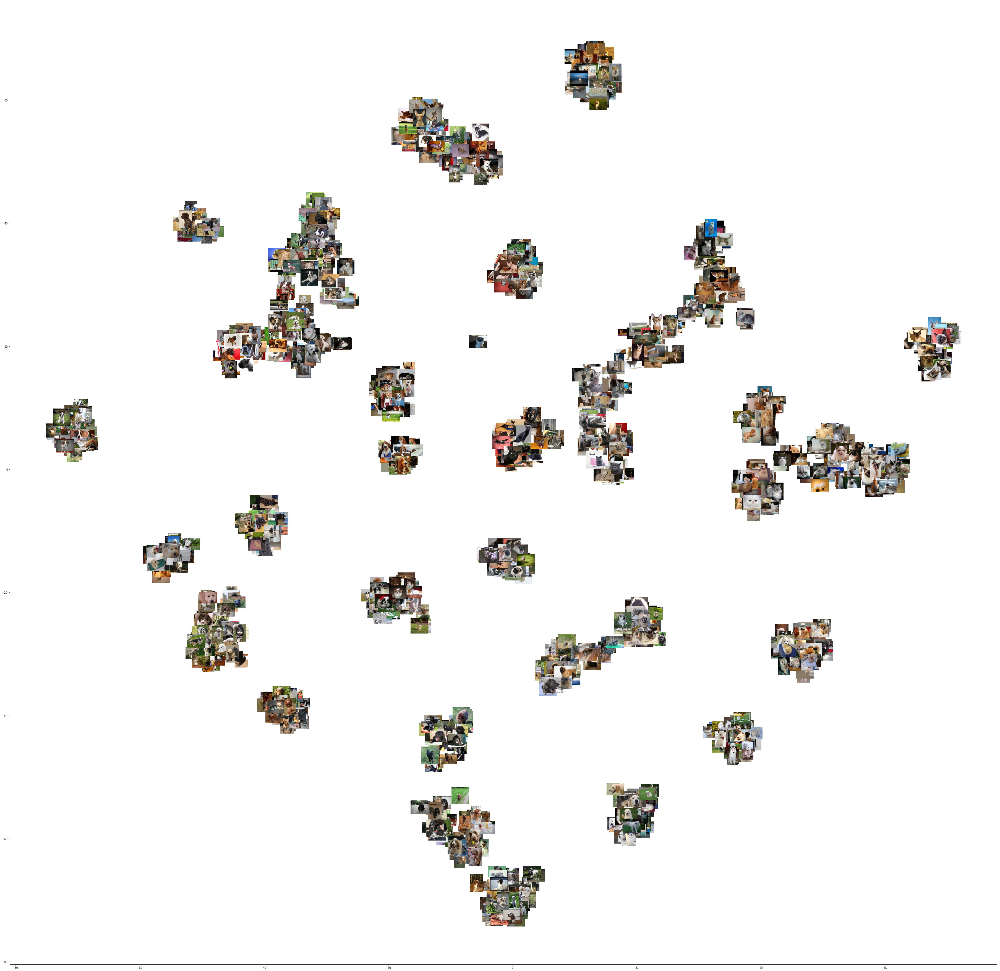

In [39]:
fig, ax = visualize_scatter_with_images(probs_trans, prob_df, image_zoom=1, suffix='probabilities')
plt.show()

Most of the clustering looks good. There are two areas that look particularly messy though.

First: the Cat Gradient

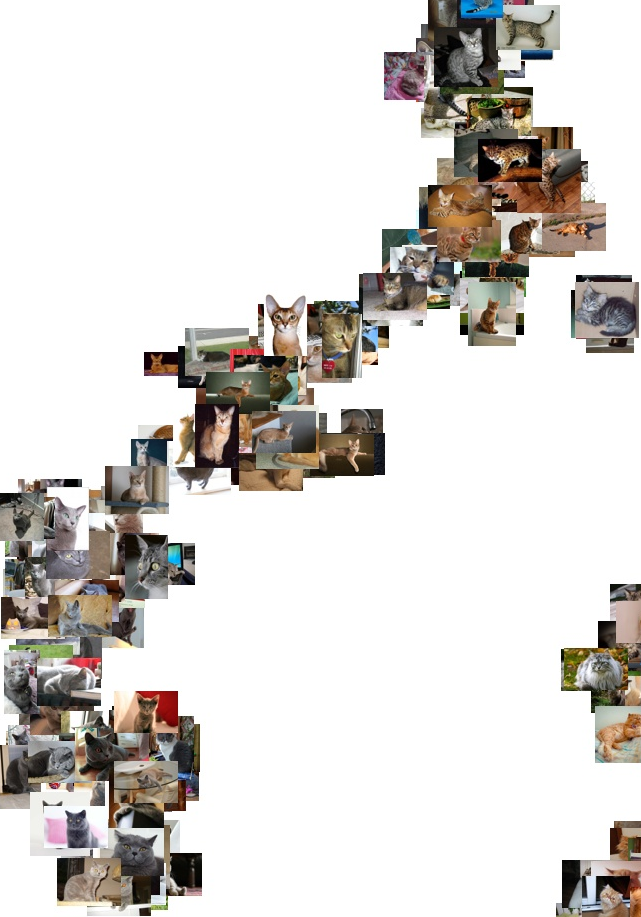

In [57]:
PIL.Image.open('media/TSNE_prob_z1.PNG')

And the Dog Blob

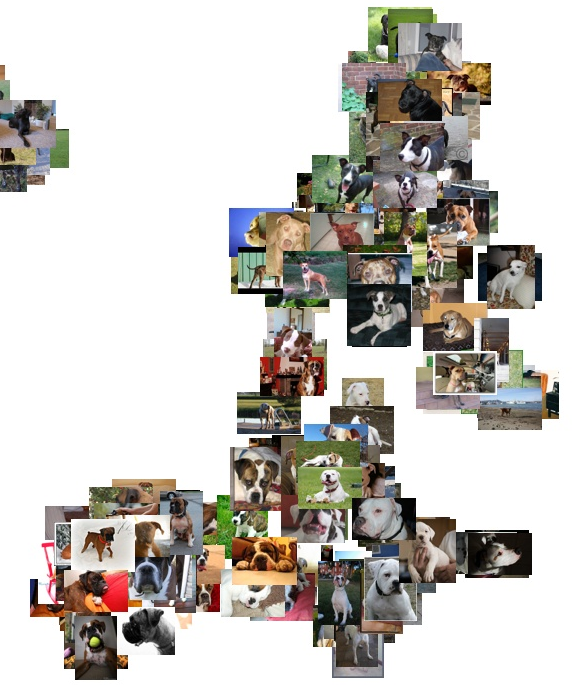

In [58]:
PIL.Image.open('media/TSNE_prob_z2.PNG')

We can see how the model's ability to differentiate classes develops through the various layers.

In [13]:
class SaveFeatures_ng():
    features=None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): self.features = output.detach()
    def remove(self): self.hook.remove()

In [15]:
y_vals = learn.data.valid_ds.ds.y[:1280]
f_names = learn.data.valid_ds.ds.x[:1280]

In [20]:
def get_activs(l1, l2):
    it = iter(learn.data.valid_dl)
    sfs_lst = []
    m = learn.model.eval()
    sf = SaveFeatures_ng(children(m)[l1][l2])
    
    for i in range(10):
        x, y = next(it)
        p = m(x)
        sfs_lst.append(to_np(sf.features.cpu().detach()))
        sf.remove
    
    return sfs_lst

These activations are from the final convolutional layer at the end of the resnet backbone

In [21]:
sfs = get_activs(0, 7)

In [22]:
sfs_cat = np.concatenate(sfs)

In [23]:
sfs_cat.shape

(1280, 512, 7, 7)

In [24]:
sfs_cat = sfs_cat.reshape((1280, -1))

In [25]:
conv_tsne = manifold.TSNE(n_components=2, perplexity=15).fit_transform(sfs_cat)

In [26]:
prob_df = pd.DataFrame(np.concatenate((conv_tsne, y_vals[:,None]), axis=1), columns=['x','y','labels'])

We see the data has started to form defined but loose clusters at this stage. Some clusters are well isolated, others are mixed with different classes

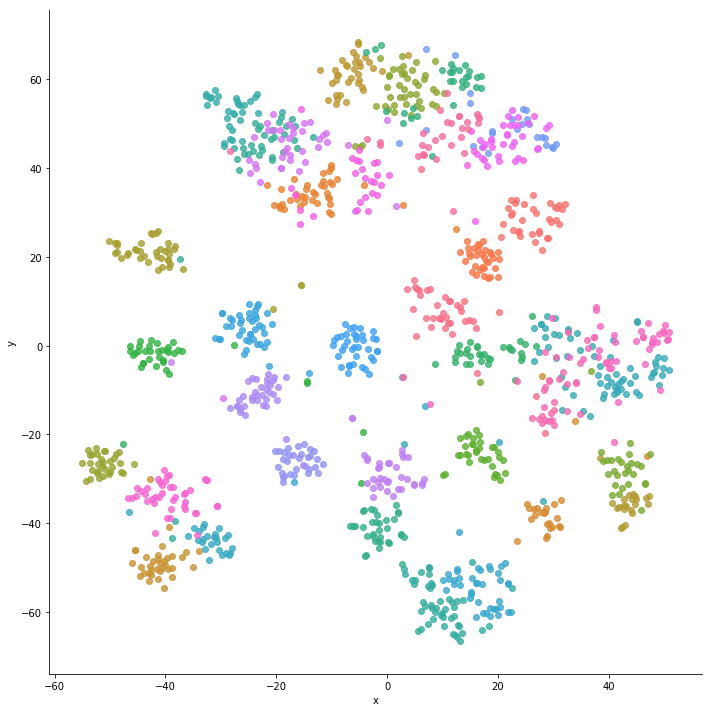

In [27]:
g = sns.lmplot('x', 'y', data=prob_df, hue='labels', fit_reg=False, legend=False, height=10)

In [28]:
prob_df['fname'] = f_names

Adding images reveals some interesting features. Cats all cluster near one side of the image, while dogs cluster on the other. Overall cat classes seem less defined than dog classes. The Dog Blob is also present as a large amorphous mass.

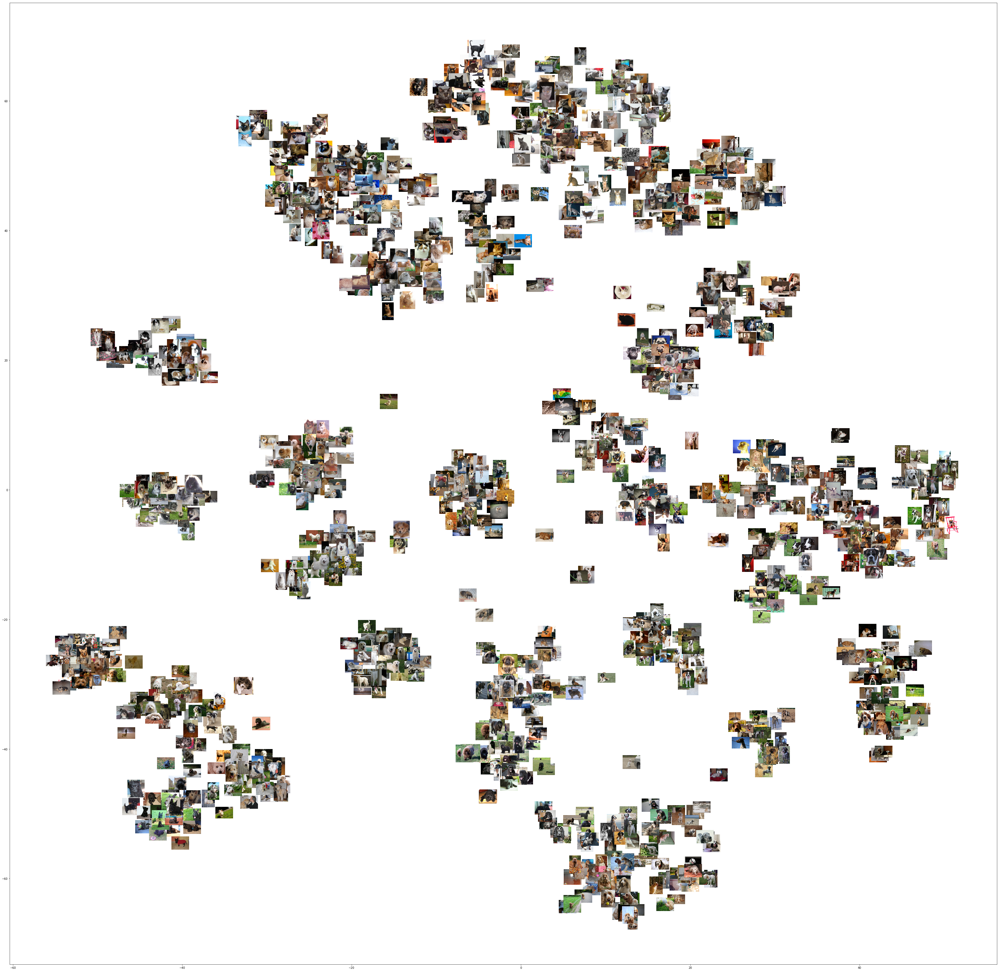

In [29]:
fig, ax = visualize_scatter_with_images(conv_tsne, prob_df, image_zoom=1, suffix='conv7')
plt.show()

Well clustered dogs

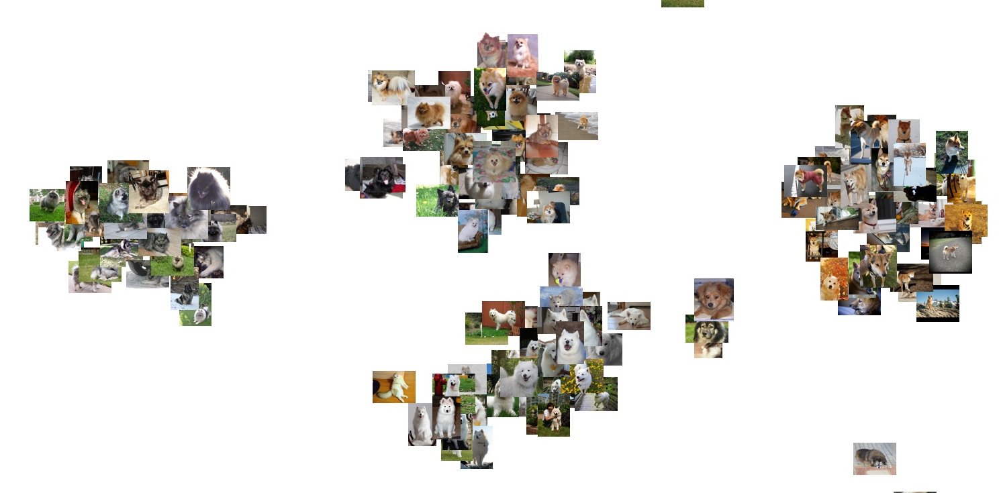

In [48]:
PIL.Image.open('media/TSNE_conv7_z1.PNG')

Cats - mostly a jumble at this stage of the model

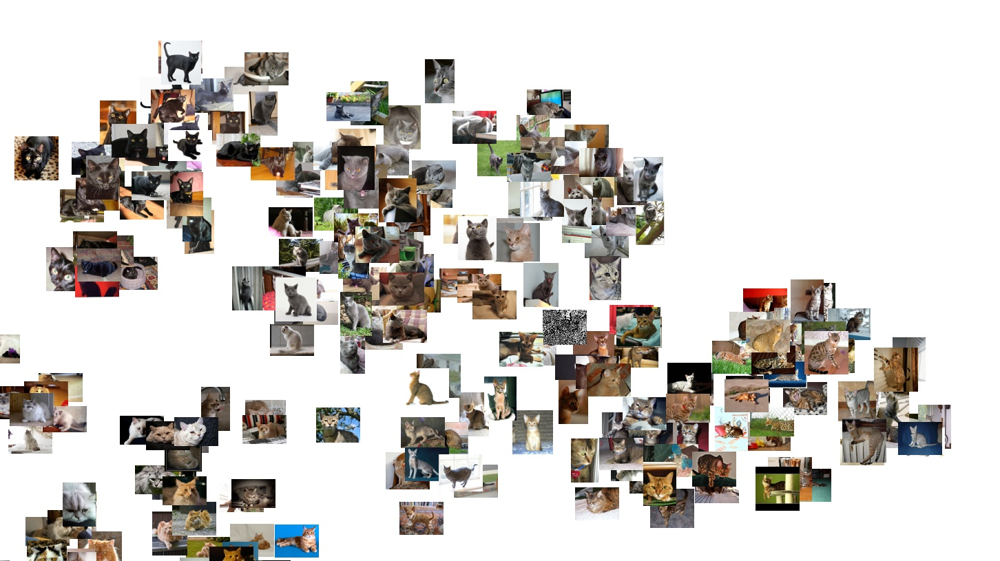

In [49]:
PIL.Image.open('media/TSNE_conv7_z2.PNG')

Poorly clustered dogs

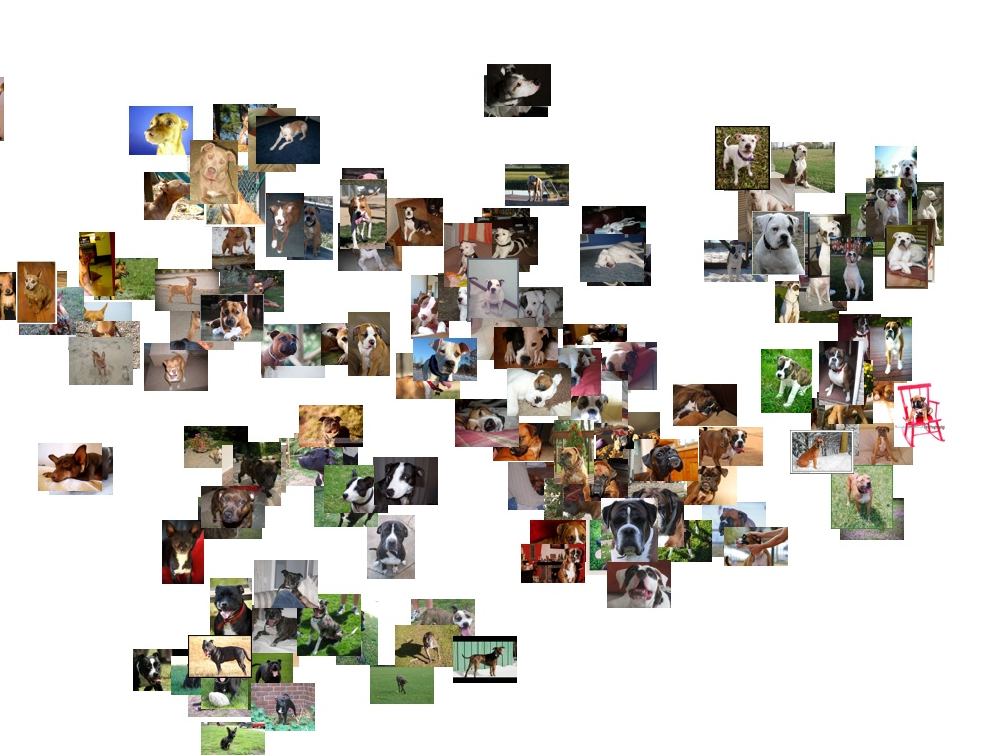

In [50]:
PIL.Image.open('media/TSNE_conv7_z3.PNG')

The output from the final conv layer is then maxpooled, batchnormed and non-linearized with a Relu. These next activations are from just before the first linear layer. Each image is represented by a 1x1024 vector.

In [31]:
sfs = get_activs(1, 3)

In [32]:
sfs_cat = np.concatenate(sfs)

In [33]:
sfs_cat.shape

(1280, 1024)

In [34]:
linear_tsne = manifold.TSNE(n_components=2, perplexity=15).fit_transform(sfs_cat)

In [35]:
prob_df = pd.DataFrame(np.concatenate((linear_tsne, y_vals[:,None]), axis=1), columns=['x','y','labels'])

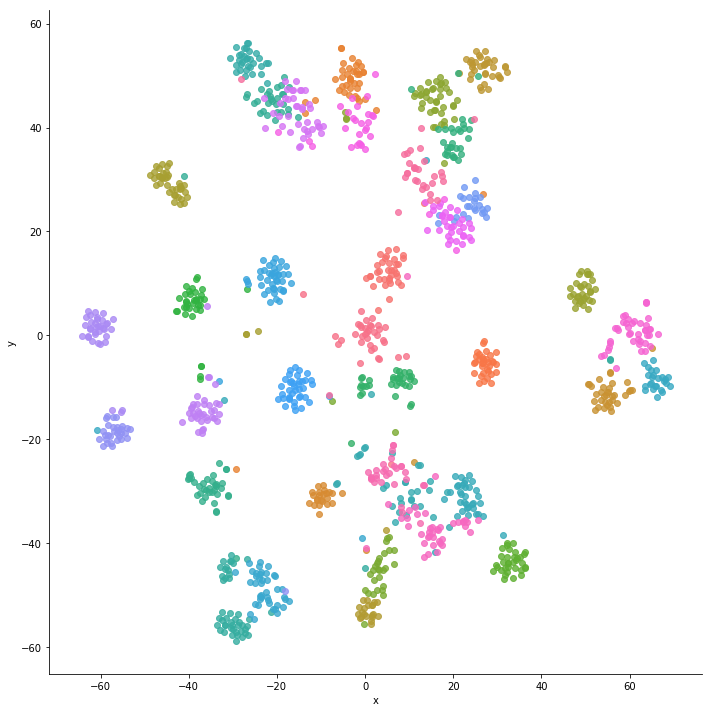

In [36]:
g = sns.lmplot('x', 'y', data=prob_df, hue='labels', fit_reg=False, legend=False, height=10)

In [37]:
prob_df['fname'] = f_names

The cat classes has begun to separate. The Dog Blob has started to pull apart. The well clustered classes from before are growing tighter.

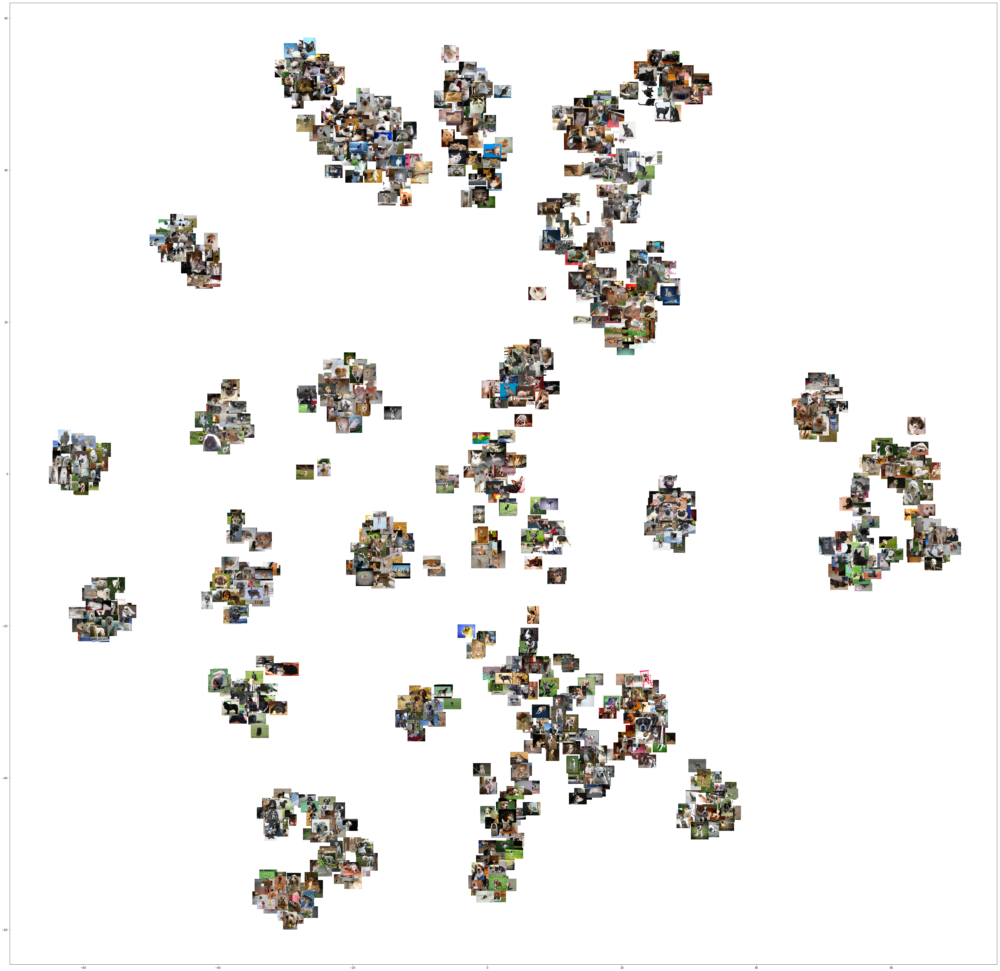

In [38]:
fig, ax = visualize_scatter_with_images(linear_tsne, prob_df, image_zoom=1, suffix='linear3')
plt.show()

Cats, beginning to pull apart

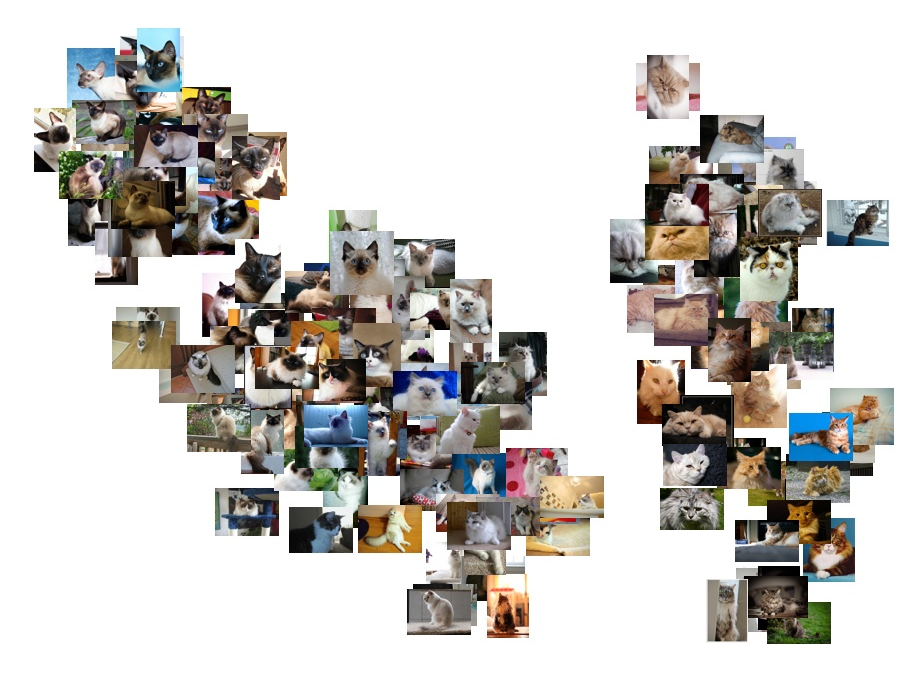

In [51]:
PIL.Image.open('media/TSNE_linear3_z1.PNG')

Interesting clustering of dogs with fluffy faces

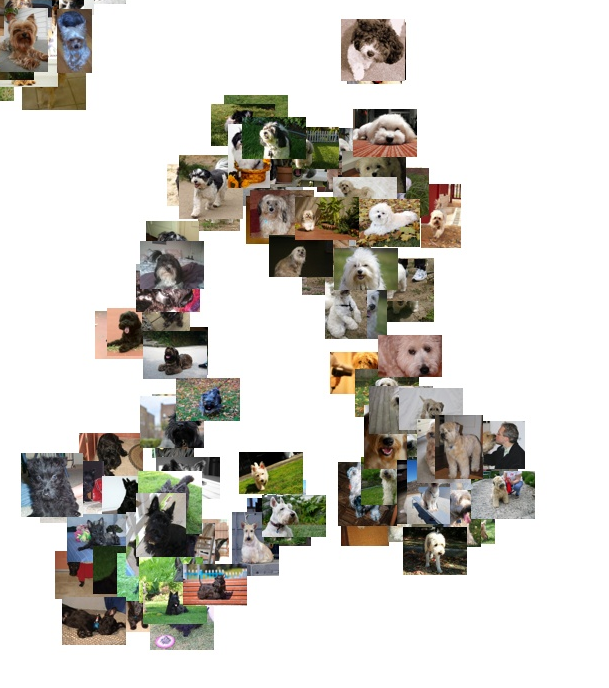

In [52]:
PIL.Image.open('media/TSNE_linear3_z2.PNG')

Dog Blob refines itself

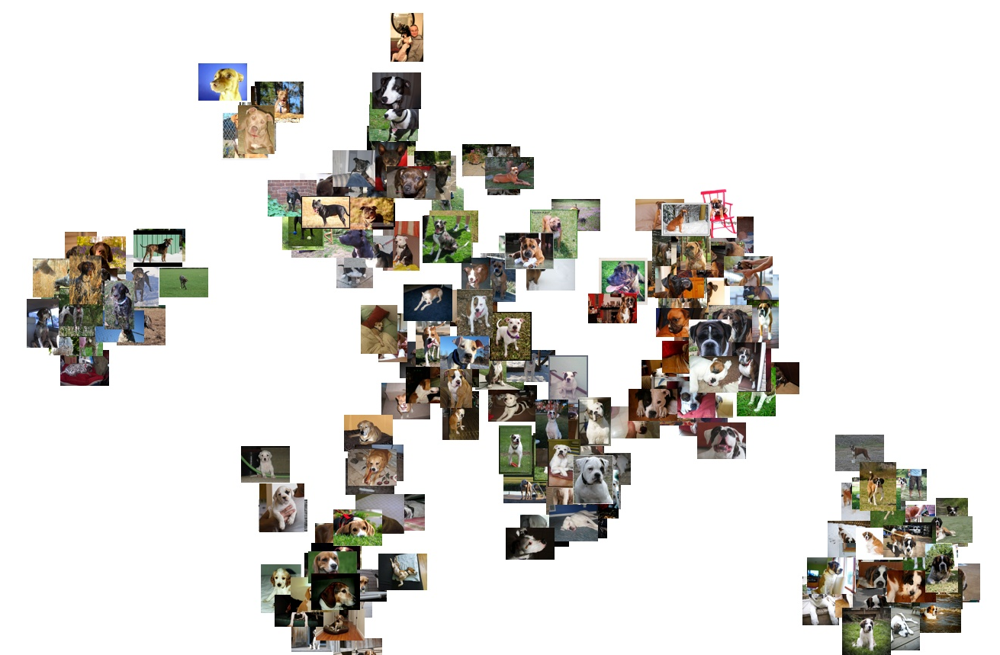

In [54]:
PIL.Image.open('media/TSNE_linear3_z3.PNG')

These activations are from just before the final linear layer used to get predictions. We would expect pretty good clusters here.

In [39]:
sfs = get_activs(1, 7)

In [40]:
sfs_cat = np.concatenate(sfs)

In [41]:
sfs_cat.shape

(1280, 512)

In [42]:
linear_tsne = manifold.TSNE(n_components=2, perplexity=15).fit_transform(sfs_cat)

In [43]:
prob_df = pd.DataFrame(np.concatenate((linear_tsne, y_vals[:,None]), axis=1), columns=['x','y','labels'])

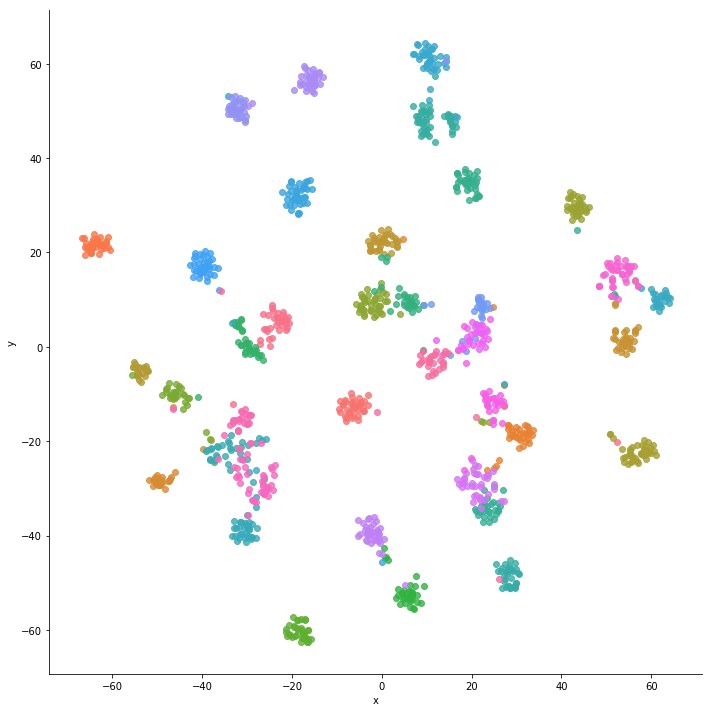

In [44]:
g = sns.lmplot('x', 'y', data=prob_df, hue='labels', fit_reg=False, legend=False, height=10)

In [45]:
prob_df['fname'] = f_names

The clusters here are almost the final product. 

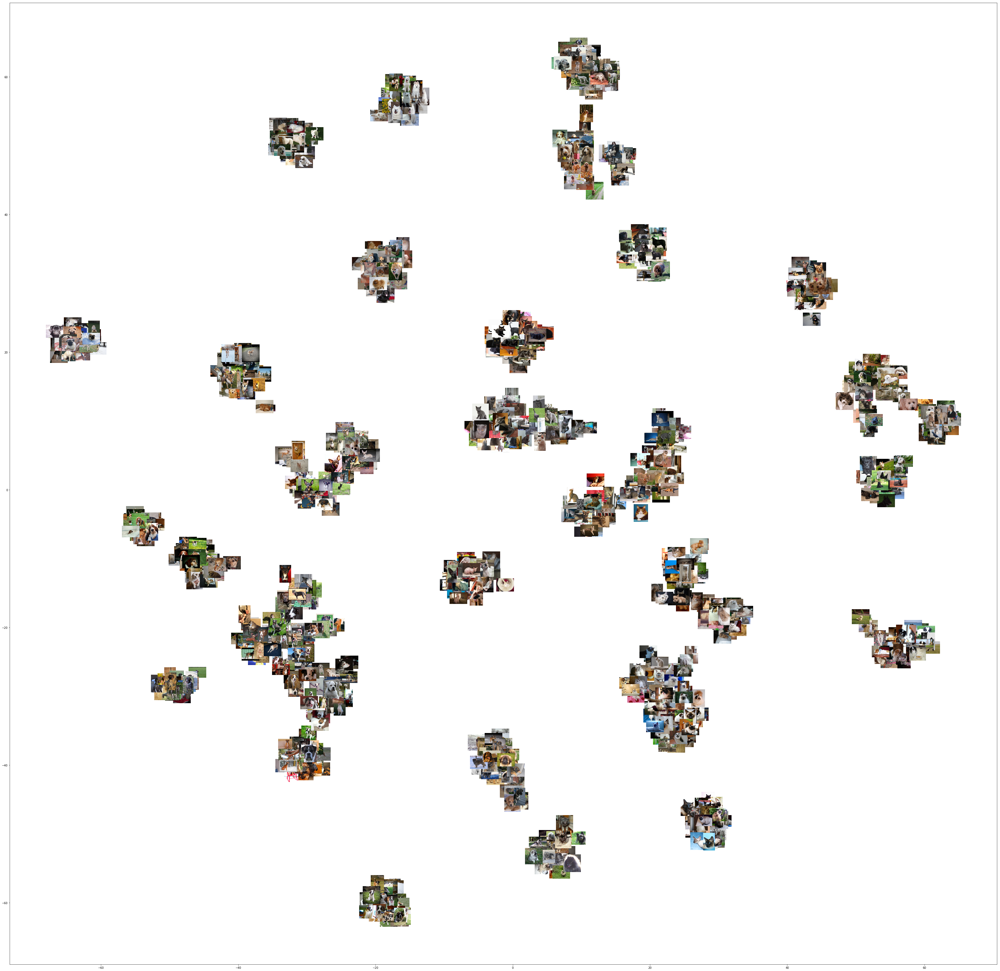

In [46]:
fig, ax = visualize_scatter_with_images(linear_tsne, prob_df, image_zoom=1, suffix='linear7')
plt.show()

Cat classes, well separated

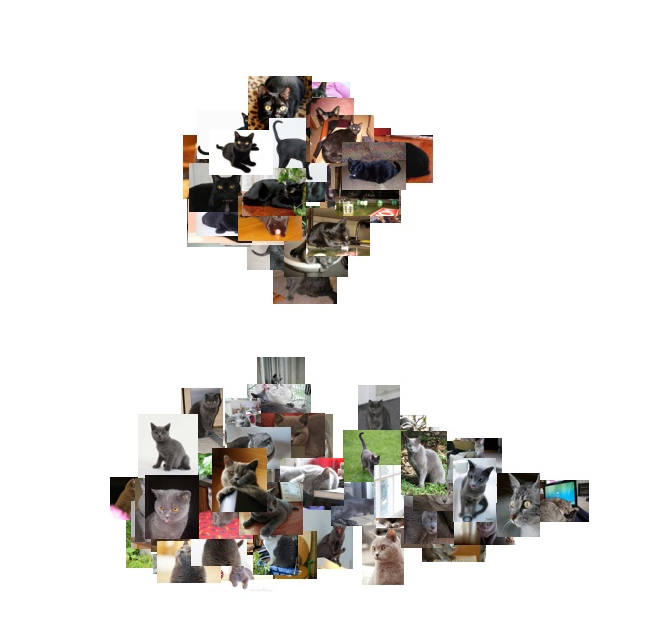

In [55]:
PIL.Image.open('media/TSNE_linear7_z1.PNG')

The dogblob remains

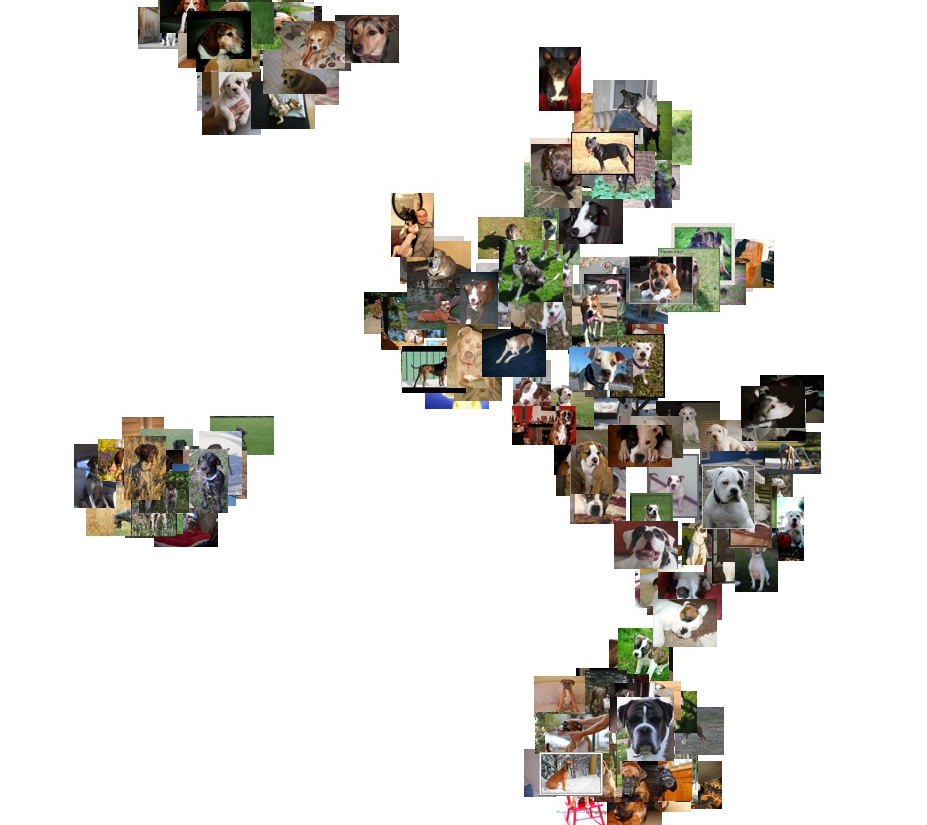

In [56]:
PIL.Image.open('media/TSNE_linear7_z2.PNG')

We can also use activations to see how the input image is processed at different convolutional layers

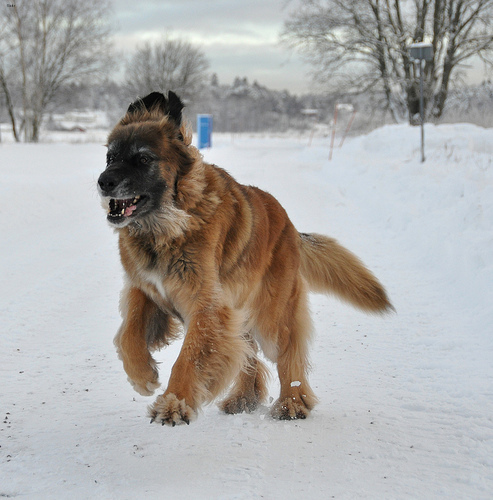

In [14]:
PIL.Image.open(learn.data.valid_ds.ds.x[17])

In [15]:
m = learn.model.eval()

In [16]:
sfs = [SaveFeatures_ng(children(m)[0][i]) for i in range(len(children(m)[0]))]

In [17]:
x, y = next(iter(learn.data.valid_dl))

In [18]:
p = m(x[17][None])

In [19]:
[i.features.shape for i in sfs]

[torch.Size([1, 64, 112, 112]),
 torch.Size([1, 64, 112, 112]),
 torch.Size([1, 64, 112, 112]),
 torch.Size([1, 64, 56, 56]),
 torch.Size([1, 64, 56, 56]),
 torch.Size([1, 128, 28, 28]),
 torch.Size([1, 256, 14, 14]),
 torch.Size([1, 512, 7, 7])]

Looking through the progression of layers, we can see how the model breaks the dog in the image apart from the background and convolves the image down

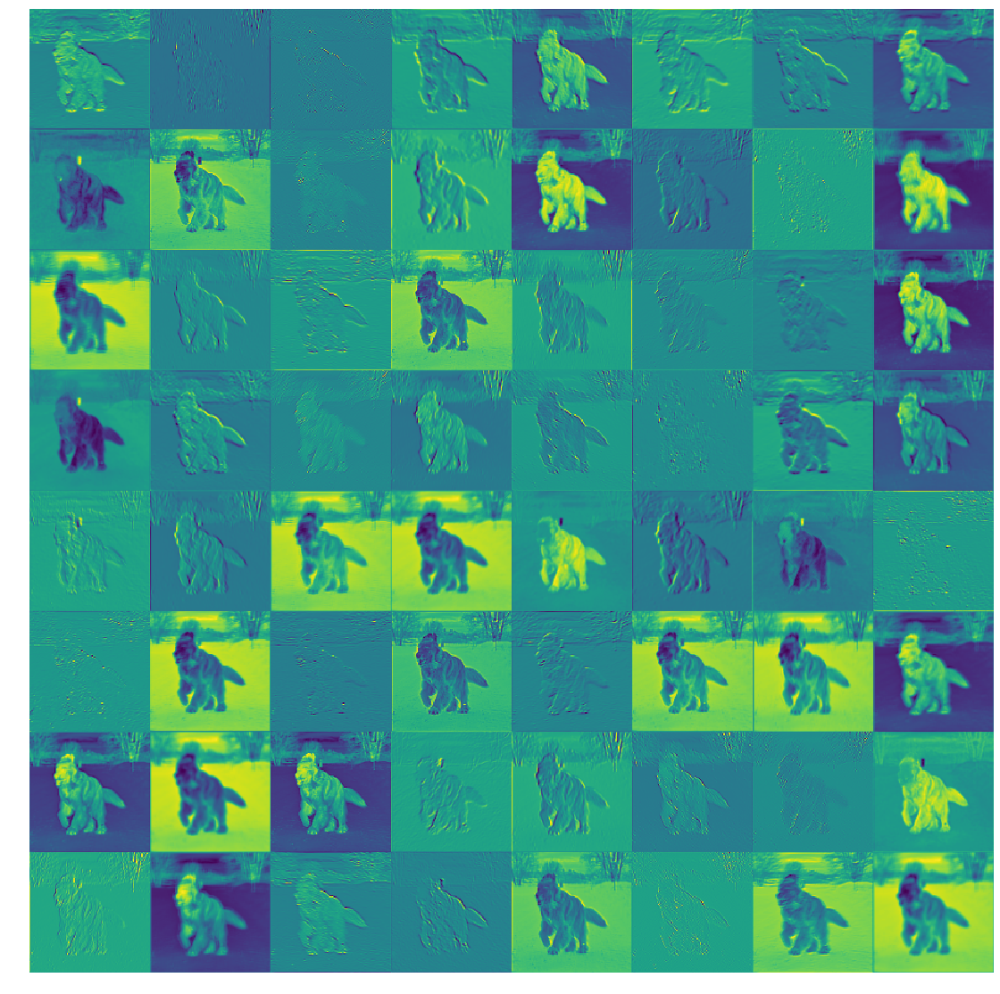

In [30]:
activs = sfs[0].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

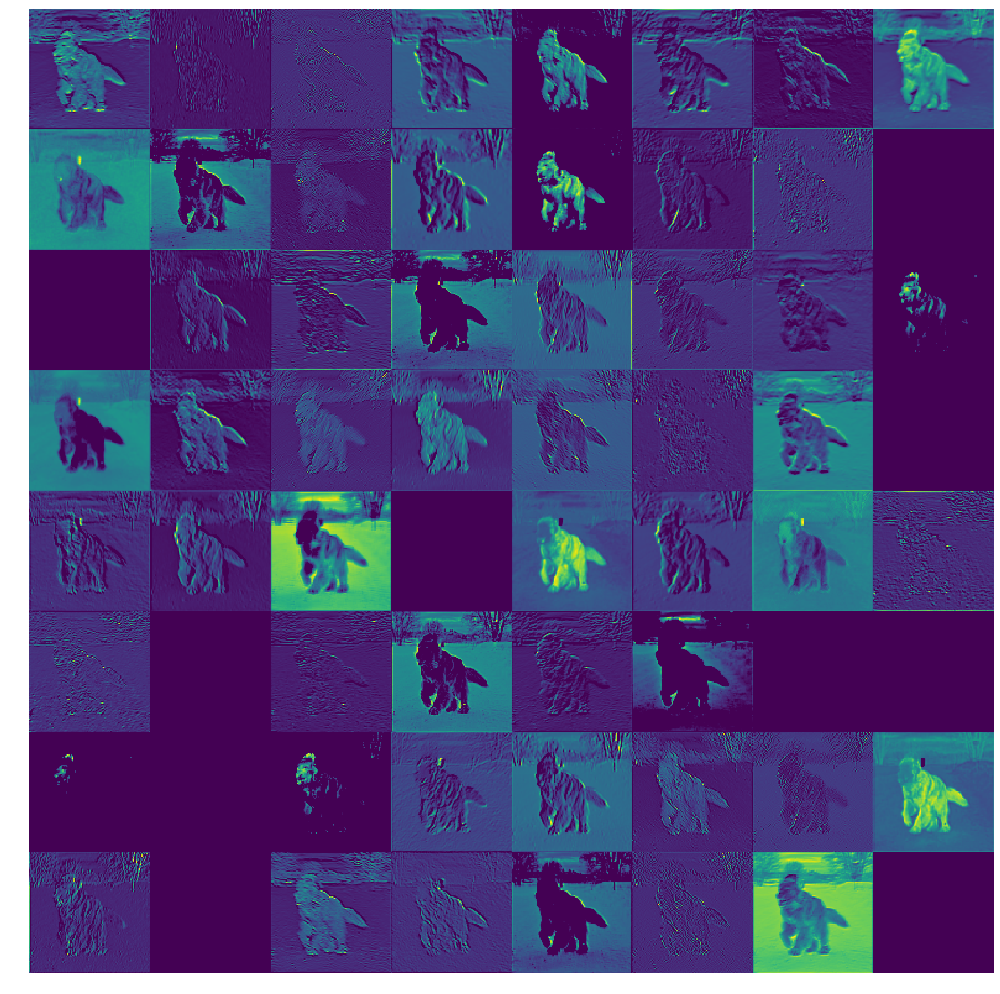

In [31]:
activs = sfs[1].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

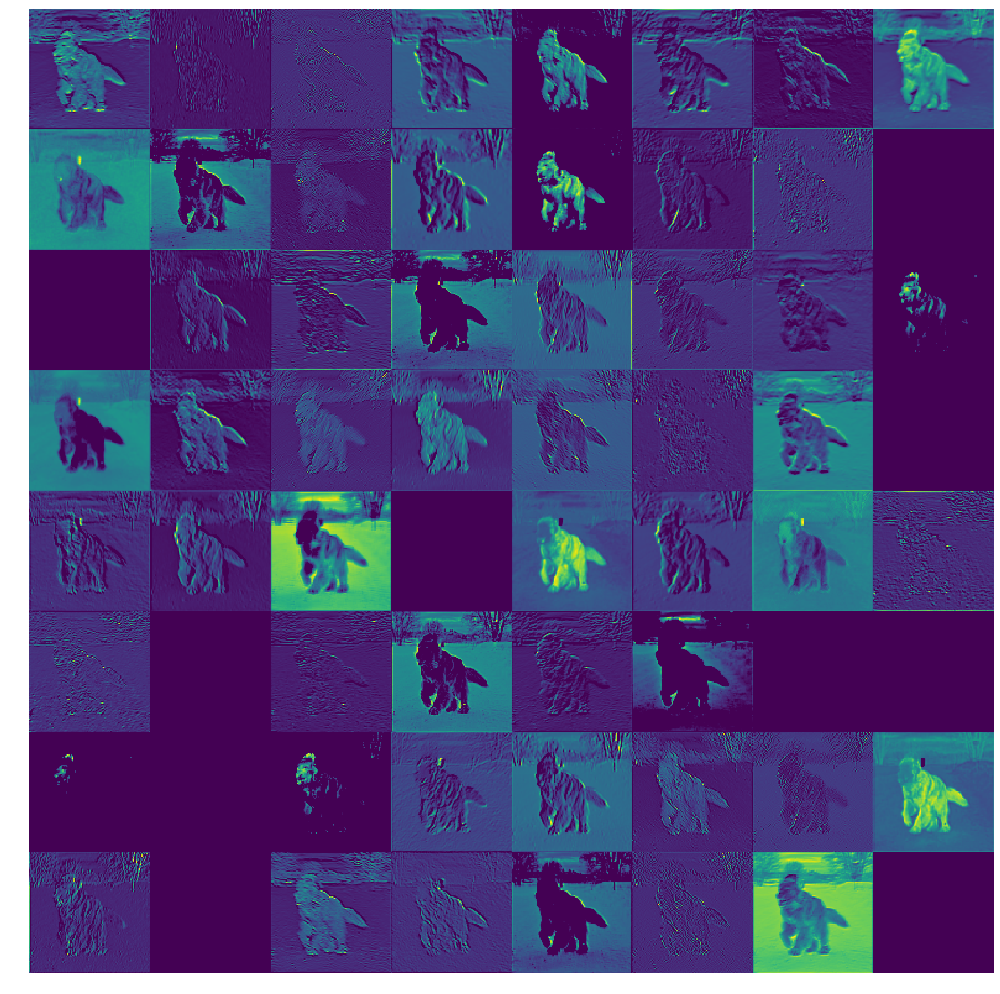

In [32]:
activs = sfs[2].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

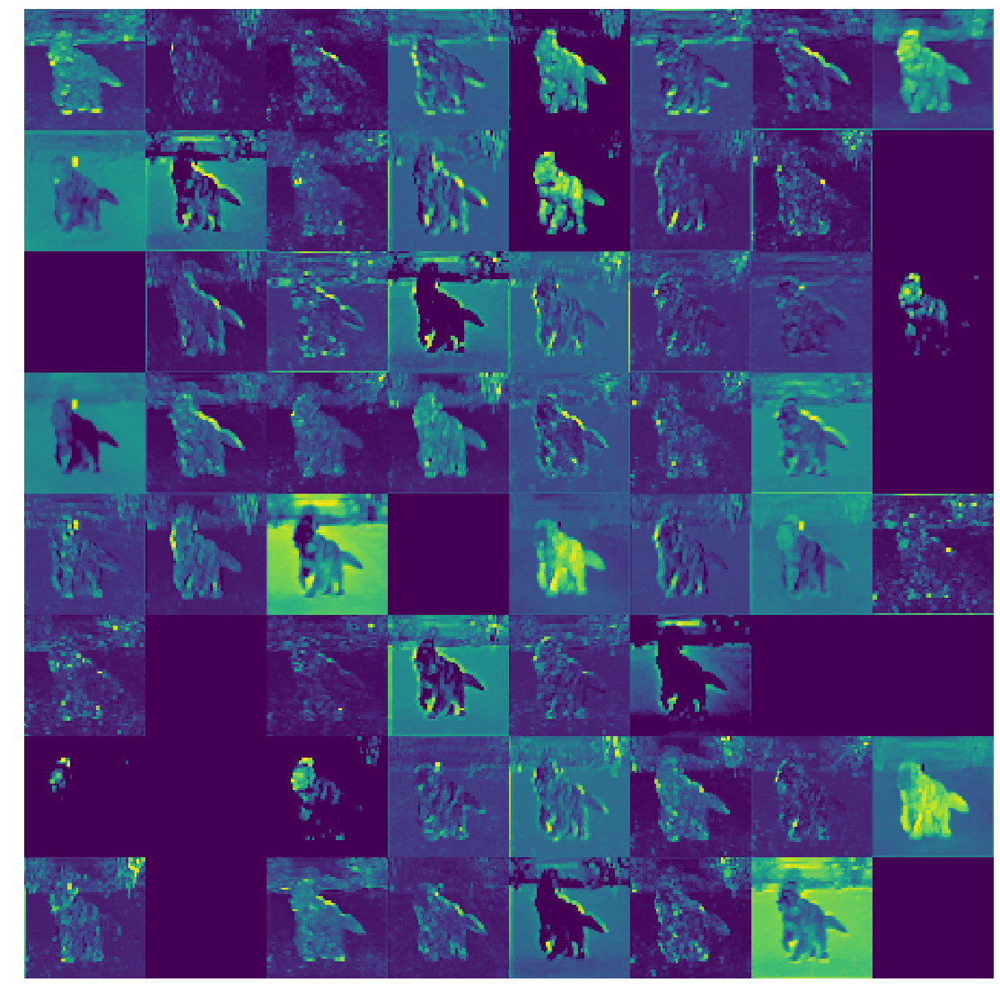

In [33]:
activs = sfs[3].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

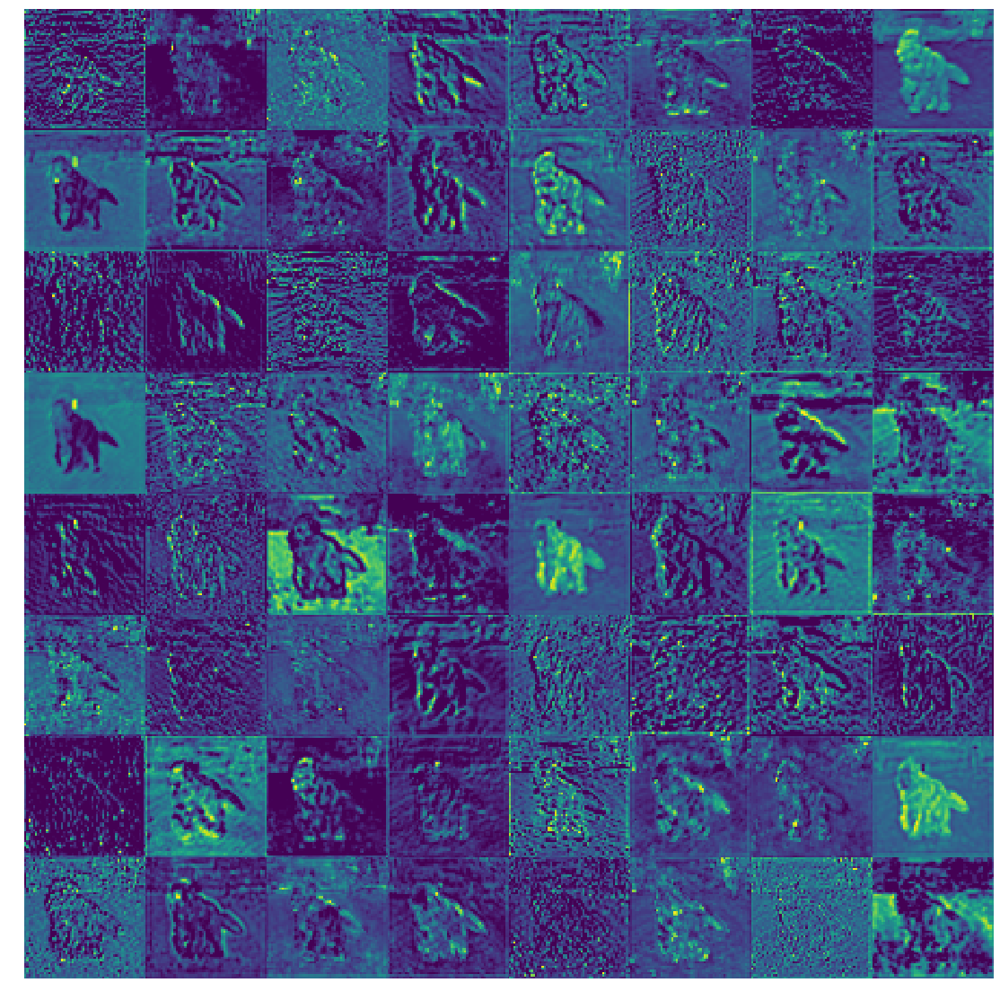

In [34]:
activs = sfs[4].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

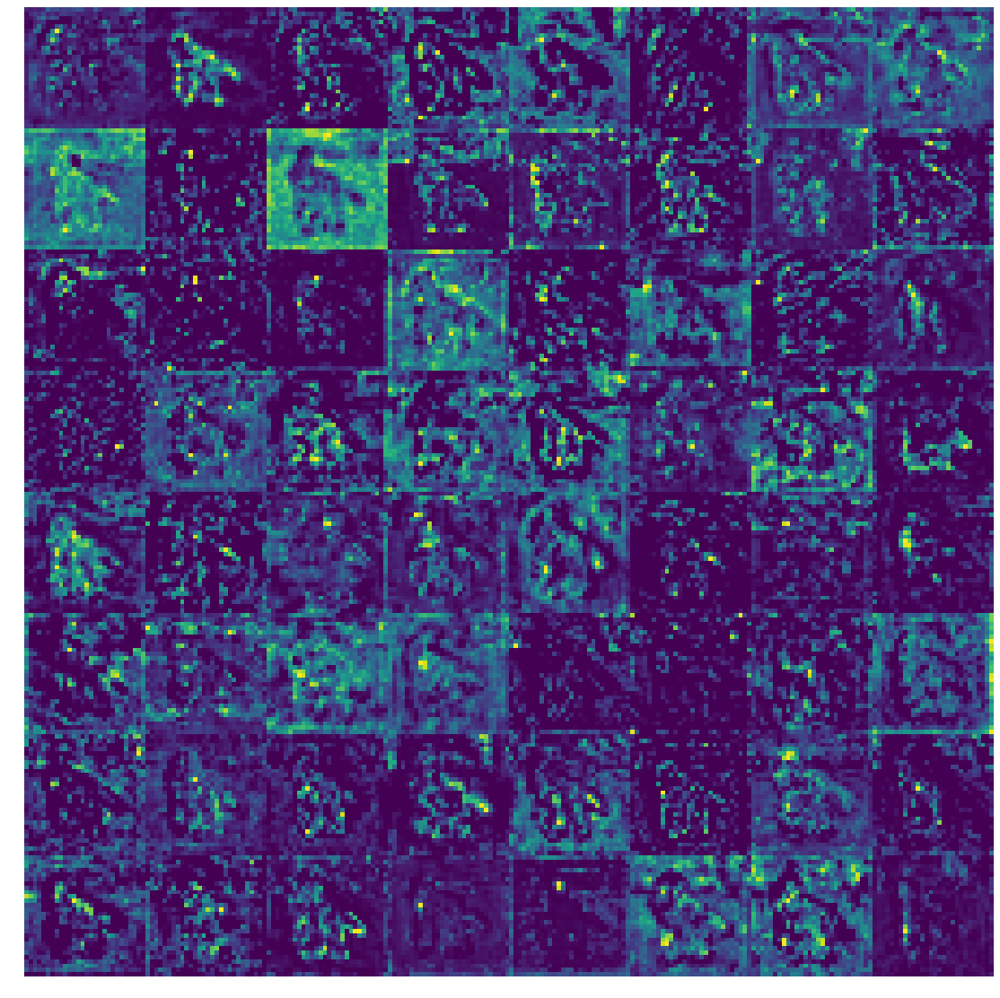

In [35]:
activs = sfs[5].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

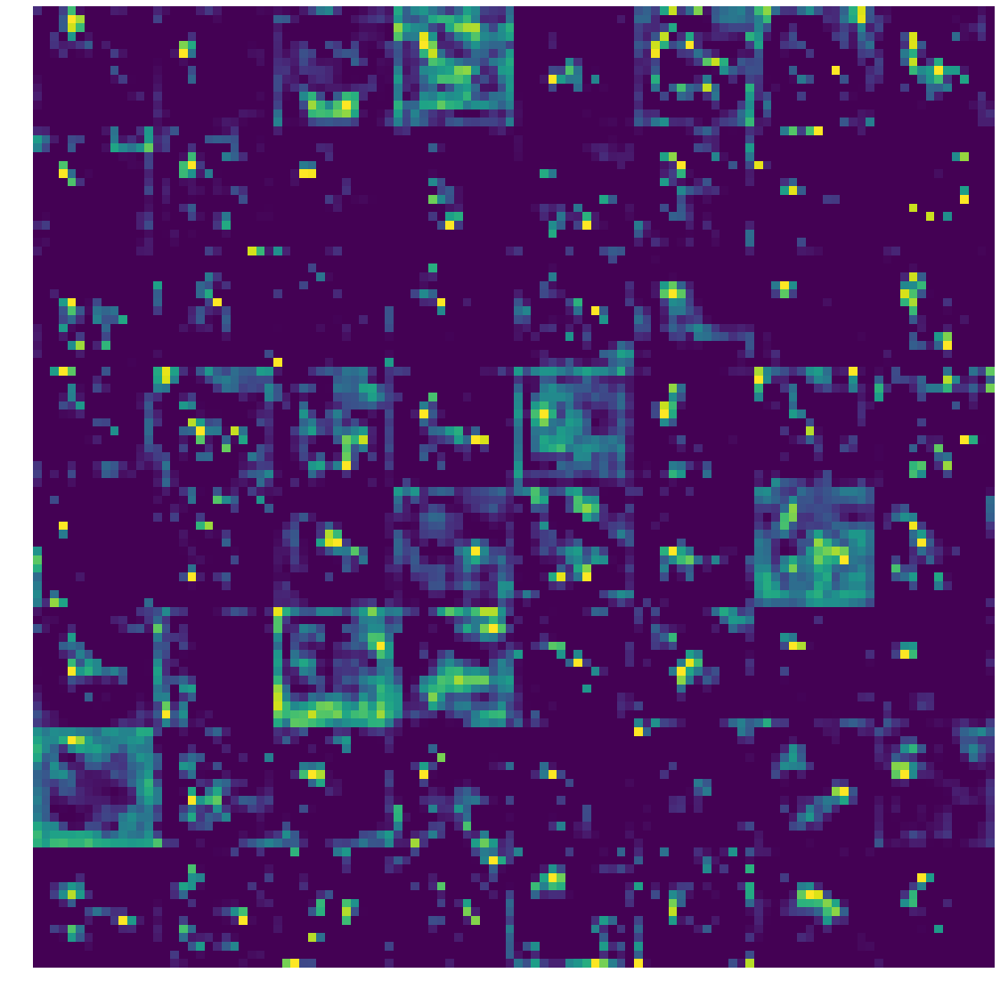

In [36]:
activs = sfs[6].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()

Dog: Distilled

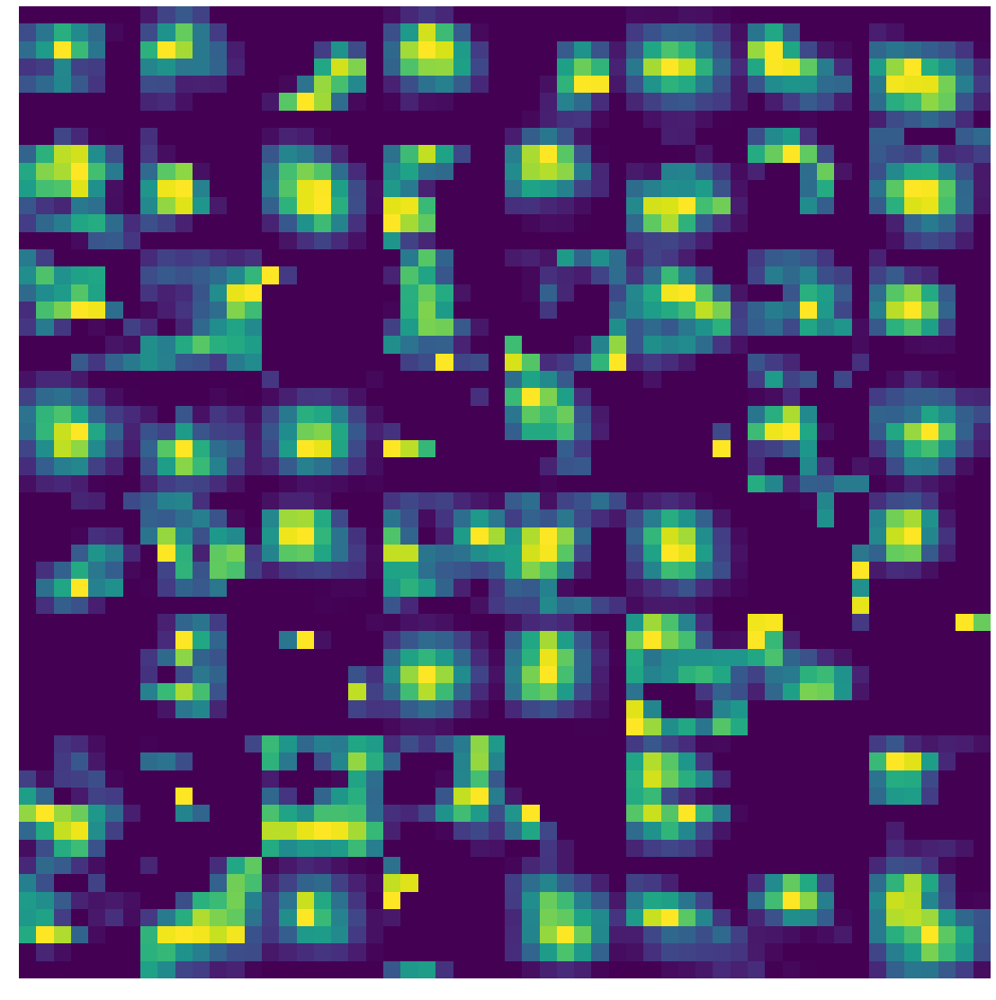

In [37]:
activs = sfs[7].features.detach().cpu().numpy()[0]
fig, axes = plt.subplots(8,8, figsize=(15,15))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)
for i, ax in enumerate(axes.flat):
    ax.imshow(activs[i])
    ax.set_axis_off()